<a href="https://colab.research.google.com/github/IA2021UR/trabajo-ia-en-la-comunidad-de-la-rioja-equipo-9/blob/main/trabajo_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# La Rioja En la Memoria

El objetivo de este proyecto es crear un modelo que clasifique las imágenes de manera que averigue de que década es entre 1860 y 1990.

## Descarga de datos necesarios

Lo primero que vamos a hacer es descargar las librerías que necesitaremos:

In [1]:
!pip install fastai --upgrade

     |████████████████████████████████| 204kB 30.5MB/s 
     |████████████████████████████████| 61kB 7.7MB/s 
  Found existing installation: fastai 1.0.61
    Uninstalling fastai-1.0.61:
      Successfully uninstalled fastai-1.0.61


In [2]:
from fastai.vision.all import *
import os
from google.colab import files
from sklearn.model_selection import train_test_split
import shutil

Descargamos el Excel que contiene los metadatos de las imágenes.

In [3]:
!wget 'https://docs.google.com/uc?export=download&id=1uRaliPHH4aTPZr9MY_REgYOgg8EvsyL_' -O LaRiojaEnLaMemoria.xlsx

--2021-05-31 14:39:31--  https://docs.google.com/uc?export=download&id=1uRaliPHH4aTPZr9MY_REgYOgg8EvsyL_
Resolving docs.google.com (docs.google.com)... 142.251.33.206, 2607:f8b0:4004:837::200e
Connecting to docs.google.com (docs.google.com)|142.251.33.206|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://doc-0k-88-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/pevp86mdic3r8m594abb38hc2ue4gb9g/1622471925000/07282892397646052687/*/1uRaliPHH4aTPZr9MY_REgYOgg8EvsyL_?e=download [following]
--2021-05-31 14:39:32--  https://doc-0k-88-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/pevp86mdic3r8m594abb38hc2ue4gb9g/1622471925000/07282892397646052687/*/1uRaliPHH4aTPZr9MY_REgYOgg8EvsyL_?e=download
Resolving doc-0k-88-docs.googleusercontent.com (doc-0k-88-docs.googleusercontent.com)... 172.217.164.129, 2607:f8b0:4004:814::2001
Connecting to doc-0k-88-docs.googleusercontent.com (doc-0k-88-docs.goog

Transformamos el xlsx en un csv para poder crear un Dataframe y así mover las imágenes a las carpetas correspondientes.

In [4]:
import xlrd
import csv
def csv_from_excel():
    wb = xlrd.open_workbook('LaRiojaEnLaMemoria.xlsx')
    sh = wb.sheet_by_name('Sheet 1')
    file = open('LaRiojaEnLaMemoria.csv', 'w')
    wr = csv.writer(file, quoting=csv.QUOTE_ALL)

    for rownum in range(sh.nrows):
        wr.writerow(sh.row_values(rownum))

    file.close()

csv_from_excel()

In [5]:
import pandas as pd
import numpy as np
df = pd.read_csv('LaRiojaEnLaMemoria.csv')


In [6]:
df.head()

,ID_NUM,IDENT,TITULO,TITULAR,DESCRIPCION,PALABRAS_CLAVE,ANNO,LUGAR,LOCALIDAD,PROVINCIA,PAIS,PROVEEDOR
0,80.0,LRM-2008/00014-Imagen,Foto con los abuelos,Fotografía de los abuelos con la nieta de dos años en Hormilleja.,NaN,NaN,1961.0,NaN,Hormilleja,NaN,NaN,NaN
1,81.0,LRM-2008/00015-Imagen,Madre e hijos en el Espolón,Madre e hijos en el Espolón.,NaN,NaN,1961.0,NaN,Logroño,NaN,NaN,NaN
2,82.0,LRM-2008/00016-Imagen,Sr.Traspaderne,Severiano Traspaderne con su furgoneta Citroen 2CV de reparto de piensos.,NaN,NaN,1964.0,NaN,Logroño,NaN,NaN,NaN
3,83.0,LRM-2008/00017-Imagen,Invierno en moto,Sr. Aragón y Sr. García pertrechados para soportar el invierno en su motol. (Rieju 125).,NaN,NaN,1964.0,NaN,Logroño,NaN,NaN,NaN
4,84.0,LRM-2008/00018-Imagen,Empujando el microcoche,Empujando un BMW Isetta,NaN,NaN,1962.0,NaN,Logroño,NaN,NaN,NaN


Los nombres de las imágenes corresponden con el ID_NUM del dataframe, por lo tanto, nos quedamos con esa columna y con ANNO, que nos dice a que año corresponde cada imagen.

In [7]:
df_columnas_de_interes = pd.concat([df['ID_NUM'],df['ANNO']], axis=1)

Transformamos el tipo de las columnas a int para poder utilizarlas más tarde.

In [8]:
df_columnas_de_interes['ID_NUM'] = df_columnas_de_interes['ID_NUM'].astype('int64')
df_columnas_de_interes['ANNO'] = df_columnas_de_interes['ANNO'].astype('int64')

In [9]:
df_columnas_de_interes.head()

,ID_NUM,ANNO
0,80,1961
1,81,1961
2,82,1964
3,83,1964
4,84,1962


In [10]:
df_columnas_de_interes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6183 entries, 0 to 6182
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   ID_NUM  6183 non-null   int64
 1   ANNO    6183 non-null   int64
dtypes: int64(2)
memory usage: 96.7 KB


In [11]:
df_columnas_de_interes.shape

(6183, 2)

Como vemos, tenemos 6183 imágenes.

Ahora descargamos el conjunto de imágenes. Las hemos guardado en dropbox ya que en Github no podíamos porque ocupaba demasiado y en Drive no nos permitía abrirlo los 3 a la vez.

In [12]:
!wget https://www.dropbox.com/s/uezjfof7id94gkt/riojamemoria.zip?dl=0 -O riojamemoria.zip

--2021-05-31 14:39:52--  https://www.dropbox.com/s/uezjfof7id94gkt/riojamemoria.zip?dl=0
Resolving www.dropbox.com (www.dropbox.com)... 162.125.6.18, 2620:100:601c:18::a27d:612
Connecting to www.dropbox.com (www.dropbox.com)|162.125.6.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/uezjfof7id94gkt/riojamemoria.zip [following]
--2021-05-31 14:39:52--  https://www.dropbox.com/s/raw/uezjfof7id94gkt/riojamemoria.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc19ebdf1b3b8f8261a564d13624.dl.dropboxusercontent.com/cd/0/inline/BPjGr6i_VNLgKNsw3ijzfTWDv38TyLAmpbDcErSV6SR-YBkI33hm-I6FmMXCnpbtGND9K8F-JgcHBaGhfUNvEOkIwlk6sFFpPBxWfc99rr2JcGAyhWodrJVzKmQD9f8hmjV19Rtj0_RqgpQug_awtrKB/file# [following]
--2021-05-31 14:39:53--  https://uc19ebdf1b3b8f8261a564d13624.dl.dropboxusercontent.com/cd/0/inline/BPjGr6i_VNLgKNsw3ijzfTWDv38TyLAmpbDcErSV6SR-YBkI33hm-I6FmMXCnpbtGND9K8F-J

Descomprimimos el fichero.

In [13]:
!unzip riojamemoria.zip

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: 1/29703.jpg             
  inflating: 1/37334.jpg             
  inflating: 1/36984.jpg             
  inflating: 1/26765.jpg             
  inflating: 1/589.jpg               
  inflating: 1/912.jpg               
  inflating: 1/940.jpg               
  inflating: 1/459.jpg               
  inflating: 1/34033.jpg             
  inflating: 1/11692.jpg             
  inflating: 1/28801.jpg             
  inflating: 1/941.jpg               
  inflating: 1/202.jpg               
  inflating: 1/29701.jpg             
  inflating: 1/29724.jpg             
  inflating: 1/26752.jpg             
  inflating: 1/29135.jpg             
  inflating: 1/184.jpg               
  inflating: 1/32502.jpg             
  inflating: 1/11973.jpg             
  inflating: 1/32725.jpg             
  inflating: 1/34344.jpg             
  inflating: 1/12837.jpg             
  inflating: 1/35576.jpg             
  inflating: 1/12058.jpg   

In [14]:
path = Path('data/decadas')

Definimos una función para averiguar la década de la imagen según el año.

In [15]:
def averiguar_decada(anno):
    resto = (anno)%10
    return (anno) - resto

In [16]:
averiguar_decada(1886)

1880

Creamos una carpeta por cada década:

In [17]:
for decada in range(1860,1991,10):
    (path/str(decada)).mkdir(parents=True,exist_ok=True)

In [18]:
df_columnas_de_interes.shape[0]

6183

Definimos una función para mover las imágenes a la carpeta que corresponda:

In [19]:
def mover_imagenes():
    for x in range(0,df_columnas_de_interes.shape[0]):
        identificador = df_columnas_de_interes.loc[x,'ID_NUM']
        imagen = str(identificador) + ".jpg"
        anno = averiguar_decada(df_columnas_de_interes.loc[x,'ANNO'])

        if os.path.isfile('1/'+imagen):
            shutil.move('1/'+imagen,"data/decadas/"+str(anno)+"/"+imagen)

In [20]:
mover_imagenes()

Comprobamos que las imágenes se han movido correctamente.

In [21]:
df_columnas_de_interes[df_columnas_de_interes["ID_NUM"] == 38064]

,ID_NUM,ANNO
6061,38064,1863


In [22]:
df_columnas_de_interes[df_columnas_de_interes["ID_NUM"] == 34916]

,ID_NUM,ANNO
5334,34916,1875


## Partición del dataset

Ahora dividimos las imágenes en conjunto de entrenamiento y test para cada década.
Nos hemos dado cuenta de que hay algunas décadas en las que hay muy pocas imágenes, por lo que a la hora de separar no vamos a poder en esas carpetas.

In [23]:
(path/"train").mkdir(parents=True,exist_ok=True)
(path/"test").mkdir(parents=True,exist_ok=True)

Creamos una carpeta para el conjunto de entrenamiento y otra para la de test. Partimos el dataset de manera que tengamos 80% entrenamiento y 20% de test y movemos las imágenes a la década correspondiente dentro de cada conjunto.

In [24]:
for decada in range(1860,1991,10):
    (path/"train"/str(decada)).mkdir(parents=True,exist_ok=True)
    (path/"test"/str(decada)).mkdir(parents=True,exist_ok=True)
    

In [25]:
for decada in range(1860,1991,10):
    if len(os.listdir(path/str(decada))) > 1:
        train_data, test_data = train_test_split(get_image_files(path/str(decada)),test_size=0.2,random_state=15)
        for x in train_data:
            shutil.move(str(x),path/('train/'+str(decada)+'/'+x.name))
        for x in test_data:
            shutil.move(str(x),path/('test/'+str(decada)+'/'+x.name))
    else:
        nombreImagen = os.listdir(path/str(decada))[0]
        shutil.move(path/str(decada)/nombreImagen, path/('train/'+str(decada)+'/'+nombreImagen))
    

Como vemos aquí, tenemos muchas más imágenes en los años 1950 y 1960. En cambio, en otros años no hay prácticamente imágenes, como en 1860 o 1990.

In [26]:
for i in range(1860,1991,10):
  print(len(os.listdir(path/'train'/str(i))))

1
3
20
40
74
155
272
439
484
1055
1311
785
108
1


Por último, eliminamos las carpetas que ya no necesitamos.

In [27]:
for decada in range(1860,1991,10):
    shutil.rmtree('data/decadas/'+str(decada))

Ya tenemos el dataset partido. Ahora entrenamos los modelos.
Lo primero que hacemos es crear un objeto DataBlock.

In [28]:
db = DataBlock(blocks = (ImageBlock, CategoryBlock),
                 get_items=get_image_files, 
                 splitter=RandomSplitter(valid_pct=0.2,seed=42),
                 get_y=parent_label,
                 item_tfms = Resize(512),
                 batch_tfms=aug_transforms(size=256,min_scale=0.75))

In [29]:
trainPath = Path('data/decadas/train')

In [30]:
dls = db.dataloaders(trainPath,bs=128)

Mostramos algunas imágenes del dataset para comprobar que se han cargado correctamente.

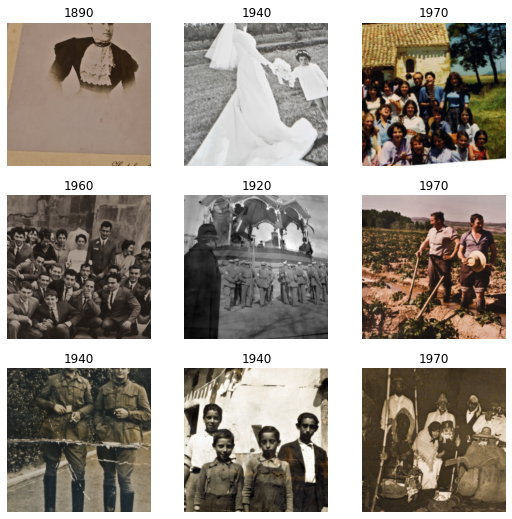

In [31]:
dls.show_batch()

Ahora probamos distintos modelos:

## Resnet34

### Creando el modelo de predicción

In [ ]:
learn = cnn_learner(dls,resnet18,metrics=accuracy).to_fp16()

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth


### Entrenando el modelo

In [ ]:
learn.fine_tune(10,base_lr=1e-3)

epoch,train_loss,valid_loss,accuracy,time
0,3.812660,2.567194,0.281349,06:00


epoch,train_loss,valid_loss,accuracy,time
0,3.184991,2.498255,0.298209,06:00
1,3.052813,2.366117,0.315068,05:54
2,2.852098,2.285848,0.341412,05:53
3,2.625393,2.149206,0.368809,05:52
4,2.402869,2.118724,0.373024,05:54
5,2.214220,2.025681,0.382508,05:54
6,2.061218,1.982476,0.398314,05:54
7,1.924132,1.977506,0.396207,05:55
8,1.825034,1.977598,0.398314,06:05
9,1.765673,1.963779,0.396207,06:03


In [ ]:
interp = ClassificationInterpretation.from_learner(learn)

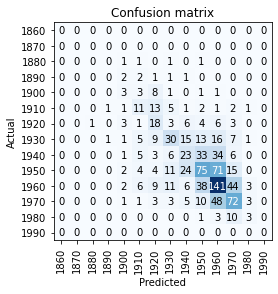

In [ ]:
interp.plot_confusion_matrix()

In [ ]:
learn1 = cnn_learner(dls, resnet34, pretrained=True, metrics=error_rate).to_fp16()

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth


In [ ]:
learn1.fit_one_cycle(10)

epoch,train_loss,valid_loss,error_rate,time
0,2.403813,2.076514,0.616438,05:55
1,2.262264,4.577504,0.708114,05:58
2,2.144404,1.831484,0.643836,05:56
3,2.034438,6.135750,0.776607,05:58
4,1.886364,2.292770,0.637513,06:00
5,1.722384,1.762556,0.600632,05:59
6,1.576326,1.698854,0.628030,06:00
7,1.448028,1.570832,0.578504,06:01
8,1.319052,1.535629,0.544784,06:00
9,1.184137,1.535812,0.545838,06:02


In [ ]:
learn1.save('stage-1')

Path('models/stage-1.pth')

In [ ]:
learn1.unfreeze()

SuggestedLRs(lr_min=6.309573450380412e-08, lr_steep=2.2908675418875646e-06)

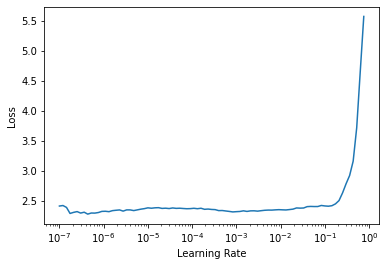

In [ ]:
learn1.lr_find()

In [ ]:
learn1.fit_one_cycle(2, lr_max=slice(1e-4, 1e-3))

### Evaluación del conjunto de test

In [ ]:
dbTest = DataBlock(blocks = (ImageBlock, CategoryBlock),
                 get_items=get_image_files, 
                 splitter=GrandparentSplitter(valid_name='test'),
                 get_y=parent_label,
                 item_tfms = Resize(256),
                 batch_tfms=aug_transforms(size=128,min_scale=0.75))
dlsTest = dbTest.dataloaders(path,bs=128)

In [ ]:
learn.dls = dlsTest

In [ ]:
learn.validate()

(#2) [3.0338616371154785,0.2156040221452713]

Ahora exportamos el mejor modelo:

In [ ]:
learn.export()

In [ ]:
!ls data/

decadas


### Predicciones

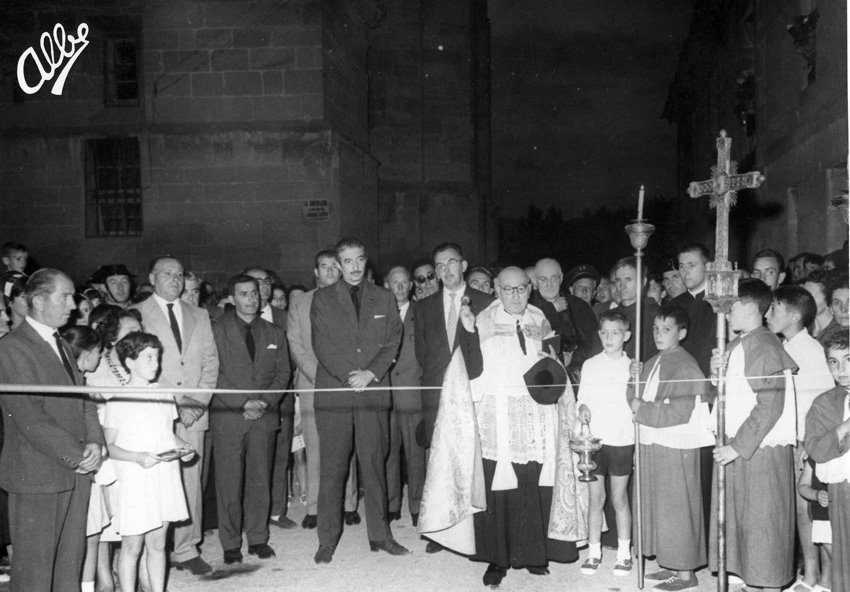

In [ ]:
import PIL

#1960
img1 = PILImage.create('1001.jpg')
img1

In [ ]:
pred_class,pred_idx,outputs=learn.predict(img1)
pred_class

'1950'

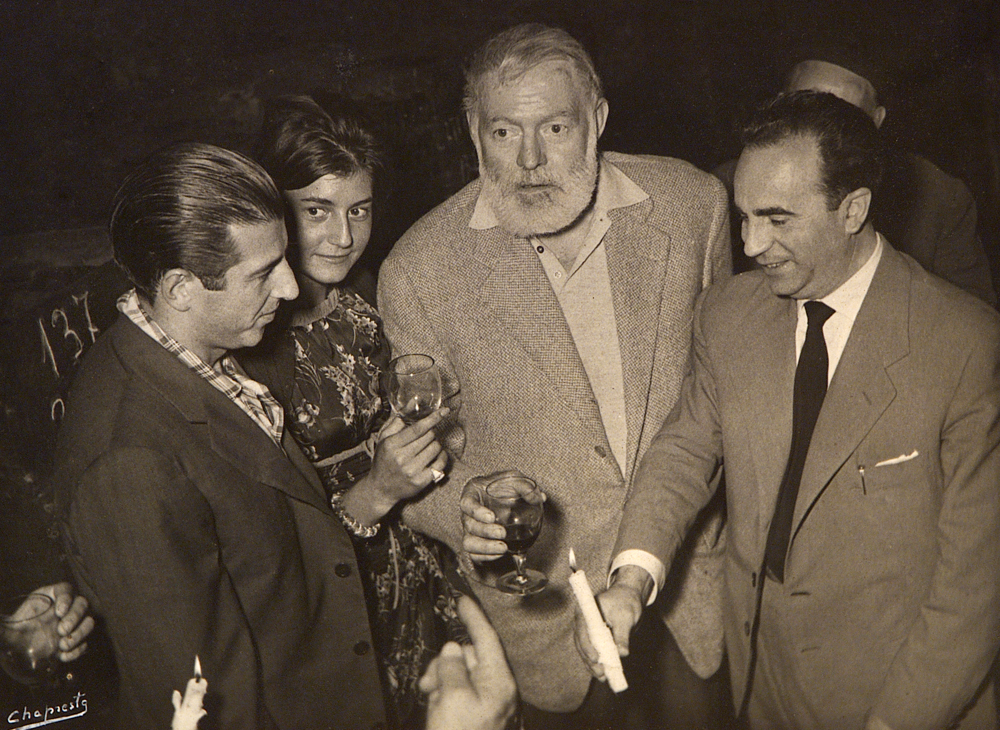

In [ ]:
#1950
img2 = PILImage.create('1040.jpg')
img2

In [ ]:
pred_class,pred_idx,outputs=learn.predict(img2)
pred_class

'1960'

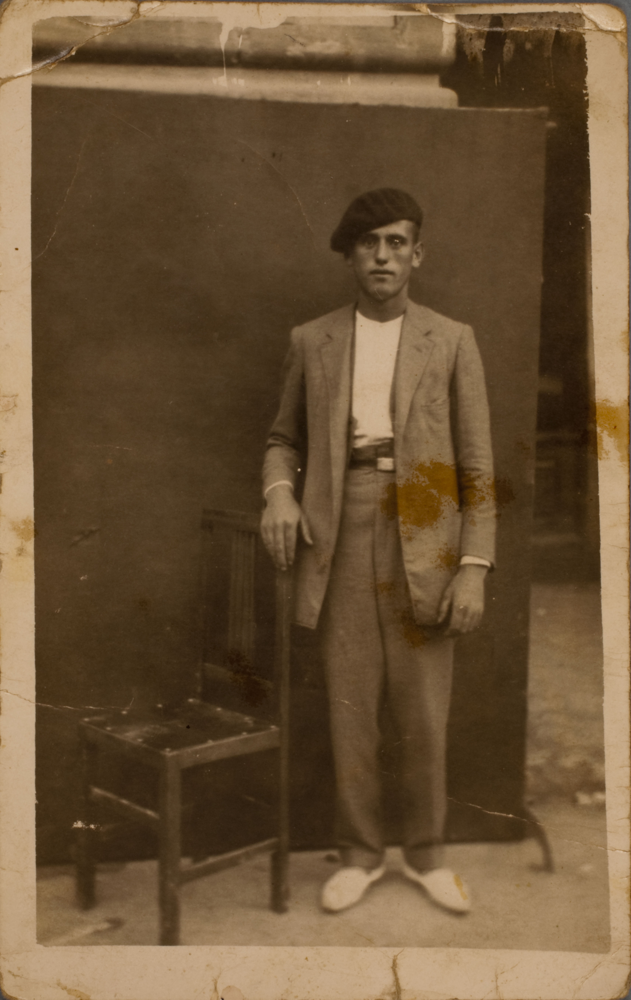

In [ ]:
#1940
img3 = PILImage.create('999.jpg')
img3

In [ ]:
pred_class,pred_idx,outputs=learn.predict(img3)
pred_class

'1950'

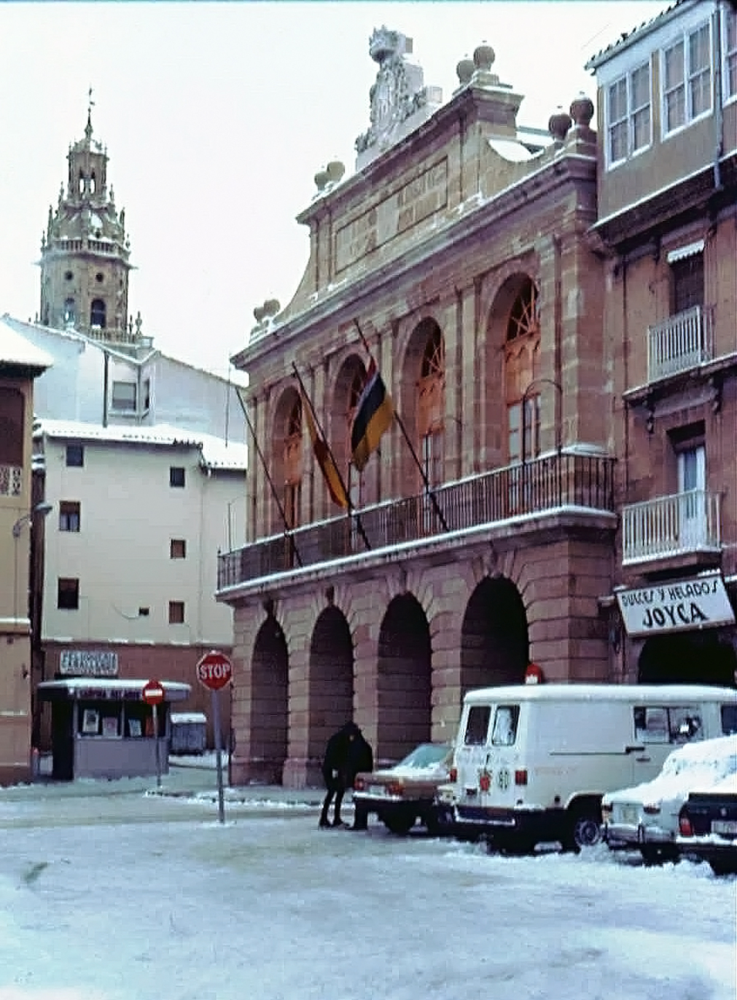

In [ ]:
#1980
img4 = PILImage.create('38060.jpg')
img4

In [ ]:
pred_class,pred_idx,outputs=learn.predict(img4)
pred_class

'1970'

Como podemos observar, nuestro modelo se equivoca en una decada en todas las predicciones.

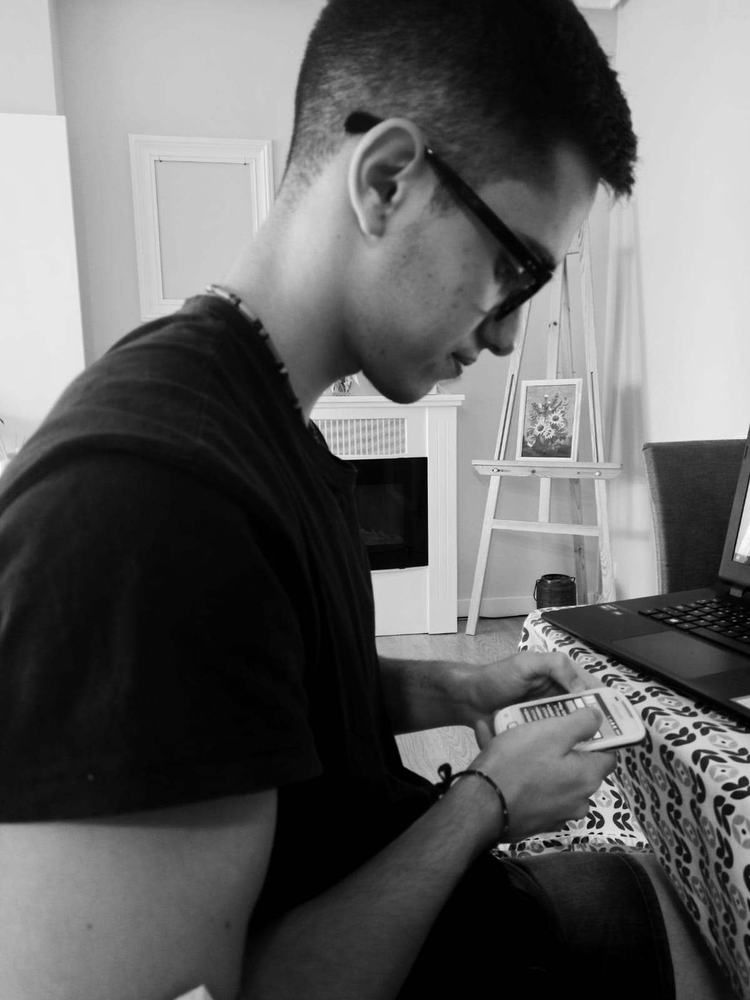

In [ ]:
#1980
img4 = PILImage.create('ChemaEnLaPrehistroia.jpeg')
img4

In [ ]:
pred_class,pred_idx,outputs=learn.predict(img4)
pred_class

'1970'

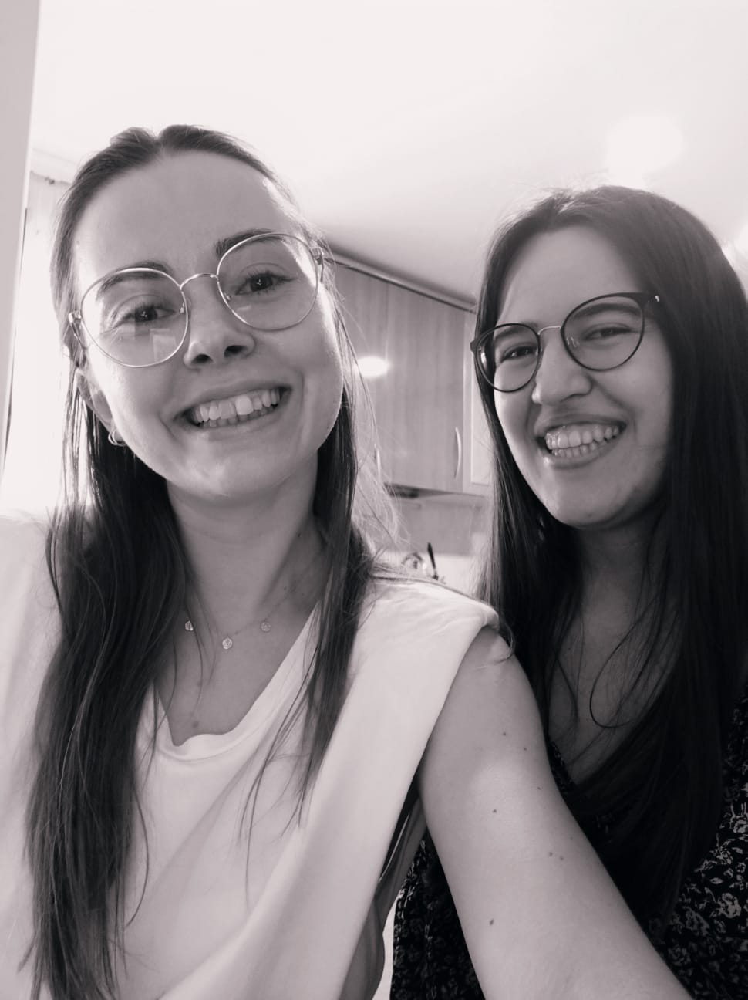

In [ ]:
#1950
img5 = PILImage.create('LuYAle.jpeg')
img5

In [ ]:
pred_class,pred_idx,outputs=learn.predict(img5)
pred_class

'1980'

## Alexnet

### Creando el modelo de predicción

In [32]:
learnAlexnet = cnn_learner(dls,alexnet,metrics=accuracy).to_fp16()

Downloading: "https://download.pytorch.org/models/alexnet-owt-4df8aa71.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-4df8aa71.pth


### Entrenando el modelo

In [33]:
learnAlexnet.fine_tune(10,base_lr=1e-3)

epoch,train_loss,valid_loss,accuracy,time
0,3.832347,2.555092,0.260274,05:56


epoch,train_loss,valid_loss,accuracy,time
0,3.201001,2.437895,0.281349,05:54
1,3.109553,2.329707,0.311907,05:47
2,2.945683,2.173767,0.324552,05:46
3,2.761545,2.056956,0.331928,05:49
4,2.604876,2.036558,0.347734,05:50
5,2.465891,1.945324,0.356164,05:50
6,2.348966,1.918988,0.355111,05:51
7,2.276354,1.926713,0.347734,05:51
8,2.211154,1.916260,0.350896,05:50
9,2.149861,1.909338,0.356164,05:50


In [34]:
interpAlexnet = ClassificationInterpretation.from_learner(learnAlexnet)

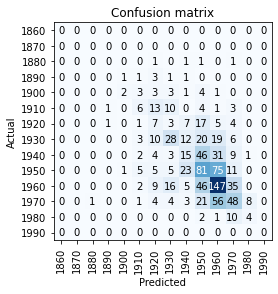

In [35]:
interpAlexnet.plot_confusion_matrix()

Como salen peores resultados, no lo evaluamos en test y probamos otro modelo.

## VGG

Otro modelo que hemos probado es el VGG, pero por problemas de espacio no nos ha permitido entrenarlo.

### Creando del modelo de predicción

In [36]:
learnVGG = cnn_learner(dls,vgg19_bn,metrics=[error_rate, accuracy])

Downloading: "https://download.pytorch.org/models/vgg19_bn-c79401a0.pth" to /root/.cache/torch/hub/checkpoints/vgg19_bn-c79401a0.pth


### Entrenando el modelo

In [40]:
learnVGG.fit_one_cycle(2)

epoch,train_loss,valid_loss,error_rate,accuracy,time


RuntimeError: ignored

In [ ]:
learnVGG.unfreeze()

## Aplicación

Por último, creamos la aplicación con el modelo que mejor nos ha salido, el de Resnet.

In [ ]:
%%bash
MINICONDA_INSTALLER_SCRIPT=Miniconda3-4.5.4-Linux-x86_64.sh
MINICONDA_PREFIX=/usr/local
wget https://repo.continuum.io/miniconda/$MINICONDA_INSTALLER_SCRIPT
chmod +x $MINICONDA_INSTALLER_SCRIPT
./$MINICONDA_INSTALLER_SCRIPT -b -f -p $MINICONDA_PREFIX

PREFIX=/usr/local
installing: python-3.6.5-hc3d631a_2 ...
installing: ca-certificates-2018.03.07-0 ...
installing: conda-env-2.6.0-h36134e3_1 ...
installing: libgcc-ng-7.2.0-hdf63c60_3 ...
installing: libstdcxx-ng-7.2.0-hdf63c60_3 ...
installing: libffi-3.2.1-hd88cf55_4 ...
installing: ncurses-6.1-hf484d3e_0 ...
installing: openssl-1.0.2o-h20670df_0 ...
installing: tk-8.6.7-hc745277_3 ...
installing: xz-5.2.4-h14c3975_4 ...
installing: yaml-0.1.7-had09818_2 ...
installing: zlib-1.2.11-ha838bed_2 ...
installing: libedit-3.1.20170329-h6b74fdf_2 ...
installing: readline-7.0-ha6073c6_4 ...
installing: sqlite-3.23.1-he433501_0 ...
installing: asn1crypto-0.24.0-py36_0 ...
installing: certifi-2018.4.16-py36_0 ...
installing: chardet-3.0.4-py36h0f667ec_1 ...
installing: idna-2.6-py36h82fb2a8_1 ...
installing: pycosat-0.6.3-py36h0a5515d_0 ...
installing: pycparser-2.18-py36hf9f622e_1 ...
installing: pysocks-1.6.8-py36_0 ...
installing: ruamel_yaml-0.15.37-py36h14c3975_2 ...
installing: six-1.11

--2021-05-30 17:21:17--  https://repo.continuum.io/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh
Resolving repo.continuum.io (repo.continuum.io)... 104.18.200.79, 104.18.201.79, 2606:4700::6812:c94f, ...
Connecting to repo.continuum.io (repo.continuum.io)|104.18.200.79|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://repo.anaconda.com/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh [following]
--2021-05-30 17:21:17--  https://repo.anaconda.com/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh
Resolving repo.anaconda.com (repo.anaconda.com)... 104.16.131.3, 104.16.130.3, 2606:4700::6810:8303, ...
Connecting to repo.anaconda.com (repo.anaconda.com)|104.16.131.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 58468498 (56M) [application/x-sh]
Saving to: ‘Miniconda3-4.5.4-Linux-x86_64.sh’

     0K .......... .......... .......... .......... ..........  0% 41.5M 1s
    50K .......... .......... .......... .......... ..........  0%

In [ ]:
! conda update -n base conda

Solving environment: - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - 

In [ ]:
! conda create -n fastai python=3.7

Solving environment: | done

## Package Plan ##

  environment location: /usr/local/envs/fastai

  added / updated specs:
    - python=3.7


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    _libgcc_mutex-0.1          |             main           3 KB
    ca-certificates-2021.5.25  |       h06a4308_1         112 KB
    certifi-2020.12.5          |   py37h06a4308_0         141 KB
    ld_impl_linux-64-2.33.1    |       h53a641e_7         568 KB
    libffi-3.3                 |       he6710b0_2          50 KB
    libgcc-ng-9.1.0            |       hdf63c60_0         5.1 MB
    libstdcxx-ng-9.1.0         |       hdf63c60_0         3.1 MB
    ncurses-6.2                |       he6710b0_1         817 KB
    openssl-1.1.1k             |       h27cfd23_0         2.5 MB
    pip-21.1.1                 |   py37h06a4308_0         1.8 MB
    python-3.7.10              |       hdb3f193_0        45.2 M

In [ ]:
%%bash
source activate fastai

In [ ]:
!pip install fastbook

     |████████████████████████████████| 727kB 4.0MB/s 
     |████████████████████████████████| 1.2MB 17.6MB/s 
     |████████████████████████████████| 51kB 7.6MB/s 
     |████████████████████████████████| 61kB 8.9MB/s 


In [ ]:
!pip install viola

In [ ]:
!python -m ipykernel install --user --name=fastai

Installed kernelspec fastai in /root/.local/share/jupyter/kernels/fastai


In [ ]:
from fastai.vision.all import *
from fastai.vision.widgets import *

In [ ]:
# Cargar modelo

path = Path('data/decadas')
learn_inf = load_learner('export.pkl', cpu=True)

btn_upload = widgets.FileUpload()
out_pl = widgets.Output()
lbl_pred = widgets.Label()

In [ ]:
# Crear Interface

def on_data_change(change):
  lbl_pred.value = ''

  img = PILImage.create(btn_upload.data[-1])
  out_pl.clear_output()
  with out_pl:
    display(img.to_thumb(224,224))

  pred, pred_idx, probs = learn_inf.predict(img)

  lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'
  

In [ ]:
btn_upload.observe(on_data_change, names=['data'])

display(VBox([widgets.Label('Select your photo:'), btn_upload, out_pl, lbl_pred]))